In [1]:
import pandas as pd
import numpy as np

import category_encoders as ce
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.preprocessing import OneHotEncoder, LabelEncoder

import matplotlib.pyplot as plt 
import seaborn as sns


In [2]:
data = pd.read_csv('Datasets/KDDTrain+.txt', header= None)
test = pd.read_csv('Datasets/KDDTest+.txt', header=None)
data.head()

,0,1,2,3,4,5,6,7,8,9,...,33,34,35,36,37,38,39,40,41,42
0,0,tcp,ftp_data,SF,491,0,0,0,0,0,...,0.17,0.03,0.17,0.00,0.00,0.00,0.05,0.00,normal,20
1,0,udp,other,SF,146,0,0,0,0,0,...,0.00,0.60,0.88,0.00,0.00,0.00,0.00,0.00,normal,15
2,0,tcp,private,S0,0,0,0,0,0,0,...,0.10,0.05,0.00,0.00,1.00,1.00,0.00,0.00,neptune,19
3,0,tcp,http,SF,232,8153,0,0,0,0,...,1.00,0.00,0.03,0.04,0.03,0.01,0.00,0.01,normal,21
4,0,tcp,http,SF,199,420,0,0,0,0,...,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,normal,21


In [3]:
columns = (['duration','protocol_type','service','flag','src_bytes','dst_bytes','land','wrong_fragment','urgent','hot','num_failed_logins','logged_in','num_compromised','root_shell','su_attempted'
,'num_root','num_file_creations','num_shells','num_access_files','num_outbound_cmds','is_host_login','is_guest_login','count','srv_count','serror_rate','srv_serror_rate','rerror_rate','srv_rerror_rate','same_srv_rate','diff_srv_rate'
,'srv_diff_host_rate','dst_host_count','dst_host_srv_count','dst_host_same_srv_rate','dst_host_diff_srv_rate','dst_host_same_src_port_rate','dst_host_srv_diff_host_rate','dst_host_serror_rate',
'dst_host_srv_serror_rate','dst_host_rerror_rate','dst_host_srv_rerror_rate','attack','level'])

data.columns = columns
test.columns = columns

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 125973 entries, 0 to 125972
Data columns (total 43 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   duration                     125973 non-null  int64  
 1   protocol_type                125973 non-null  object 
 2   service                      125973 non-null  object 
 3   flag                         125973 non-null  object 
 4   src_bytes                    125973 non-null  int64  
 5   dst_bytes                    125973 non-null  int64  
 6   land                         125973 non-null  int64  
 7   wrong_fragment               125973 non-null  int64  
 8   urgent                       125973 non-null  int64  
 9   hot                          125973 non-null  int64  
 10  num_failed_logins            125973 non-null  int64  
 11  logged_in                    125973 non-null  int64  
 12  num_compromised              125973 non-null  int64  
 13 

In [5]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22544 entries, 0 to 22543
Data columns (total 43 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   duration                     22544 non-null  int64  
 1   protocol_type                22544 non-null  object 
 2   service                      22544 non-null  object 
 3   flag                         22544 non-null  object 
 4   src_bytes                    22544 non-null  int64  
 5   dst_bytes                    22544 non-null  int64  
 6   land                         22544 non-null  int64  
 7   wrong_fragment               22544 non-null  int64  
 8   urgent                       22544 non-null  int64  
 9   hot                          22544 non-null  int64  
 10  num_failed_logins            22544 non-null  int64  
 11  logged_in                    22544 non-null  int64  
 12  num_compromised              22544 non-null  int64  
 13  root_shell      

In [6]:
data.describe()

,duration,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,num_failed_logins,logged_in,num_compromised,...,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,level
count,125973.00000,1.259730e+05,1.259730e+05,125973.000000,125973.000000,125973.000000,125973.000000,125973.000000,125973.000000,125973.000000,...,125973.000000,125973.000000,125973.000000,125973.000000,125973.000000,125973.000000,125973.000000,125973.000000,125973.000000,125973.000000
mean,287.14465,4.556674e+04,1.977911e+04,0.000198,0.022687,0.000111,0.204409,0.001222,0.395736,0.279250,...,115.653005,0.521242,0.082951,0.148379,0.032542,0.284452,0.278485,0.118832,0.120240,19.504060
std,2604.51531,5.870331e+06,4.021269e+06,0.014086,0.253530,0.014366,2.149968,0.045239,0.489010,23.942042,...,110.702741,0.448949,0.188922,0.308997,0.112564,0.444784,0.445669,0.306557,0.319459,2.291503
min,0.00000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.00000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,10.000000,0.050000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.000000
50%,0.00000,4.400000e+01,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,63.000000,0.510000,0.020000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,20.000000
75%,0.00000,2.760000e+02,5.160000e+02,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,...,255.000000,1.000000,0.070000,0.060000,0.020000,1.000000,1.000000,0.000000,0.000000,21.000000
max,42908.00000,1.379964e+09,1.309937e+09,1.000000,3.000000,3.000000,77.000000,5.000000,1.000000,7479.000000,...,255.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,21.000000


In [7]:
# Check for missing values
data.isna().sum()

duration                       0
protocol_type                  0
service                        0
flag                           0
src_bytes                      0
dst_bytes                      0
land                           0
wrong_fragment                 0
urgent                         0
hot                            0
num_failed_logins              0
logged_in                      0
num_compromised                0
root_shell                     0
su_attempted                   0
num_root                       0
num_file_creations             0
num_shells                     0
num_access_files               0
num_outbound_cmds              0
is_host_login                  0
is_guest_login                 0
count                          0
srv_count                      0
serror_rate                    0
srv_serror_rate                0
rerror_rate                    0
srv_rerror_rate                0
same_srv_rate                  0
diff_srv_rate                  0
srv_diff_h

In [8]:
# Check for missing values
test.isna().sum()

duration                       0
protocol_type                  0
service                        0
flag                           0
src_bytes                      0
dst_bytes                      0
land                           0
wrong_fragment                 0
urgent                         0
hot                            0
num_failed_logins              0
logged_in                      0
num_compromised                0
root_shell                     0
su_attempted                   0
num_root                       0
num_file_creations             0
num_shells                     0
num_access_files               0
num_outbound_cmds              0
is_host_login                  0
is_guest_login                 0
count                          0
srv_count                      0
serror_rate                    0
srv_serror_rate                0
rerror_rate                    0
srv_rerror_rate                0
same_srv_rate                  0
diff_srv_rate                  0
srv_diff_h

# Preprocessing

In [9]:
train_dataset = data.copy()
test_dataset = test.copy()

In [10]:
train_dataset.shape

(125973, 43)

In [11]:
test_dataset.shape

(22544, 43)

In [12]:
difficulty_level_train = train_dataset['level']
train_dataset.drop(columns= ['level'], inplace=True)

difficulty_level_test = test_dataset['level']
test_dataset.drop(columns= ['level'], inplace=True)

In [13]:
train_dataset

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,attack
0,0,tcp,ftp_data,SF,491,0,0,0,0,0,...,25,0.17,0.03,0.17,0.00,0.00,0.00,0.05,0.00,normal
1,0,udp,other,SF,146,0,0,0,0,0,...,1,0.00,0.60,0.88,0.00,0.00,0.00,0.00,0.00,normal
2,0,tcp,private,S0,0,0,0,0,0,0,...,26,0.10,0.05,0.00,0.00,1.00,1.00,0.00,0.00,neptune
3,0,tcp,http,SF,232,8153,0,0,0,0,...,255,1.00,0.00,0.03,0.04,0.03,0.01,0.00,0.01,normal
4,0,tcp,http,SF,199,420,0,0,0,0,...,255,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125968,0,tcp,private,S0,0,0,0,0,0,0,...,25,0.10,0.06,0.00,0.00,1.00,1.00,0.00,0.00,neptune
125969,8,udp,private,SF,105,145,0,0,0,0,...,244,0.96,0.01,0.01,0.00,0.00,0.00,0.00,0.00,normal
125970,0,tcp,smtp,SF,2231,384,0,0,0,0,...,30,0.12,0.06,0.00,0.00,0.72,0.00,0.01,0.00,normal
125971,0,tcp,klogin,S0,0,0,0,0,0,0,...,8,0.03,0.05,0.00,0.00,1.00,1.00,0.00,0.00,neptune


In [14]:
categorical_cols = ['protocol_type', 'service', 'flag']
binary_cols = ['land', 'logged_in', 'root_shell', 'su_attempted', 'is_host_login', 'is_guest_login']
target = ['attack']
non_numerical_cols = binary_cols + categorical_cols + target
numerical_cols = [col for col in train_dataset.columns if col not in non_numerical_cols ]

In [15]:
numerical_cols

['duration',
 'src_bytes',
 'dst_bytes',
 'wrong_fragment',
 'urgent',
 'hot',
 'num_failed_logins',
 'num_compromised',
 'num_root',
 'num_file_creations',
 'num_shells',
 'num_access_files',
 'num_outbound_cmds',
 'count',
 'srv_count',
 'serror_rate',
 'srv_serror_rate',
 'rerror_rate',
 'srv_rerror_rate',
 'same_srv_rate',
 'diff_srv_rate',
 'srv_diff_host_rate',
 'dst_host_count',
 'dst_host_srv_count',
 'dst_host_same_srv_rate',
 'dst_host_diff_srv_rate',
 'dst_host_same_src_port_rate',
 'dst_host_srv_diff_host_rate',
 'dst_host_serror_rate',
 'dst_host_srv_serror_rate',
 'dst_host_rerror_rate',
 'dst_host_srv_rerror_rate']

## Encoding

In [16]:
for col in categorical_cols: 
    print(f'-------- Column {col} --------')
    print(train_dataset[col].value_counts())
    print('')
    

-------- Column protocol_type --------
tcp     102689
udp      14993
icmp      8291
Name: protocol_type, dtype: int64

-------- Column service --------
http         40338
private      21853
domain_u      9043
smtp          7313
ftp_data      6860
             ...  
tftp_u           3
http_8001        2
aol              2
harvest          2
http_2784        1
Name: service, Length: 70, dtype: int64

-------- Column flag --------
SF        74945
S0        34851
REJ       11233
RSTR       2421
RSTO       1562
S1          365
SH          271
S2          127
RSTOS0      103
S3           49
OTH          46
Name: flag, dtype: int64



In [17]:
set(train_dataset.service.unique()) - set(test_dataset.service.unique()) 

{'aol', 'harvest', 'http_2784', 'http_8001', 'red_i', 'urh_i'}

In [18]:
set(train_dataset.flag.unique()) - set(test_dataset.flag.unique()) 

set()

In [19]:
# Initialize One-Hot Encoder
encoder = OneHotEncoder(handle_unknown="ignore")

## Protocol type
# Fit encoder on training data (returns a separate DataFrame)
data_ohe = pd.DataFrame(encoder.fit_transform(train_dataset[["protocol_type"]]).toarray())
data_ohe.columns = [("protocol_type_" + col) for col in encoder.categories_[0]]

# Join encoded data with original training data
train_dataset = pd.concat([train_dataset, data_ohe], axis=1)
train_dataset.drop(columns=['protocol_type'], inplace=True)

# Transform test data (returns a separate DataFrame)
data_ohe = pd.DataFrame(encoder.transform(test_dataset[["protocol_type"]]).toarray())
data_ohe.columns = [("protocol_type_" + col) for col in encoder.categories_[0]]

# Join encoded data with original test data
test_dataset = pd.concat([test_dataset, data_ohe], axis=1)
test_dataset.drop(columns=['protocol_type'], inplace=True)

## Flag
# Fit encoder on training data (returns a separate DataFrame)
data_ohe = pd.DataFrame(encoder.fit_transform(train_dataset[["flag"]]).toarray())
data_ohe.columns = [("flag_" + col) for col in encoder.categories_[0]]

# Join encoded data with original training data
train_dataset = pd.concat([train_dataset, data_ohe], axis=1)
train_dataset.drop(columns=['flag'], inplace=True)

# Transform test data (returns a separate DataFrame)
data_ohe = pd.DataFrame(encoder.transform(test_dataset[["flag"]]).toarray())
data_ohe.columns = [("flag_" + col) for col in encoder.categories_[0]]

# Join encoded data with original test data
test_dataset = pd.concat([test_dataset, data_ohe], axis=1)
test_dataset.drop(columns=['flag'], inplace=True)

# Fit Frequency encoder on training data
encoder = ce.CountEncoder(cols="service", normalize=True)

train_dataset["service_encoded_freq"] = encoder.fit_transform(train_dataset["service"])
test_dataset["service_encoded_freq"] = encoder.transform(test_dataset["service"])

train_dataset.drop(columns=['service'], inplace=True)
test_dataset.drop(columns=['service'], inplace=True)

In [20]:
train_dataset['service_encoded_freq'].value_counts()


0.320211    40338
0.173474    21853
0.071785     9043
0.058052     7313
0.054456     6860
            ...  
0.000079       10
0.000016        6
0.000040        5
0.000024        3
0.000008        1
Name: service_encoded_freq, Length: 66, dtype: int64

In [21]:
train_dataset['attack'].unique()

array(['normal', 'neptune', 'warezclient', 'ipsweep', 'portsweep',
       'teardrop', 'nmap', 'satan', 'smurf', 'pod', 'back',
       'guess_passwd', 'ftp_write', 'multihop', 'rootkit',
       'buffer_overflow', 'imap', 'warezmaster', 'phf', 'land',
       'loadmodule', 'spy', 'perl'], dtype=object)

In [22]:
test_dataset['attack'].unique()

array(['neptune', 'normal', 'saint', 'mscan', 'guess_passwd', 'smurf',
       'apache2', 'satan', 'buffer_overflow', 'back', 'warezmaster',
       'snmpgetattack', 'processtable', 'pod', 'httptunnel', 'nmap', 'ps',
       'snmpguess', 'ipsweep', 'mailbomb', 'portsweep', 'multihop',
       'named', 'sendmail', 'loadmodule', 'xterm', 'worm', 'teardrop',
       'rootkit', 'xlock', 'perl', 'land', 'xsnoop', 'sqlattack',
       'ftp_write', 'imap', 'udpstorm', 'phf'], dtype=object)

In [23]:
# Target Encoding
#Mapping all attack types to their categories
dos_attacks = ['back','land','neptune','pod','smurf','teardrop', 'apache2', 'udpstorm', 'processtable', 'worm', 'mailbomb']
probe_attacks = ['satan', 'ipsweep', 'nmap', 'portsweep', 'mscan', 'saint']
R2L_attacks = ['guess_passwd', 'ftp_write', 'imap', 'phf', 'multihop', 'warezmaster', 'warezclient', 'spy', 'xlock', 'xsnoop', 'snmpguess', 'snmpgetattack', 'httptunnel', 'sendmail', 'named']
U2R_attacks = ['rootkit', 'buffer_overflow', 'loadmodule', 'perl', 'sqlattack', 'xterm', 'ps']

def attack_category(attack):
    if attack in dos_attacks:
        attack_type = 1
    elif attack in probe_attacks:
        attack_type = 2
    elif attack in R2L_attacks:
        attack_type = 3
    elif attack in U2R_attacks:
        attack_type = 4
    elif attack == 'normal':
        attack_type = 0
    else:
        return -1
    return attack_type

train_dataset['attack_category'] = train_dataset['attack'].apply(attack_category)
train_dataset.loc[train_dataset['attack_category'] > 0, 'is_attack'] = 1
train_dataset.loc[train_dataset['attack_category'] == 0, 'is_attack'] = 0

test_dataset['attack_category'] = test_dataset['attack'].apply(attack_category)
test_dataset.loc[test_dataset['attack_category'] > 0, 'is_attack'] = 1
test_dataset.loc[test_dataset['attack_category'] == 0, 'is_attack'] = 0

In [24]:
train_dataset['is_attack']

0         0.0
1         0.0
2         1.0
3         0.0
4         0.0
         ... 
125968    1.0
125969    0.0
125970    0.0
125971    1.0
125972    0.0
Name: is_attack, Length: 125973, dtype: float64

In [25]:
train_dataset['attack'].value_counts()

normal             67343
neptune            41214
satan               3633
ipsweep             3599
portsweep           2931
smurf               2646
nmap                1493
back                 956
teardrop             892
warezclient          890
pod                  201
guess_passwd          53
buffer_overflow       30
warezmaster           20
land                  18
imap                  11
rootkit               10
loadmodule             9
ftp_write              8
multihop               7
phf                    4
perl                   3
spy                    2
Name: attack, dtype: int64

In [26]:
test_dataset['attack'].value_counts()

normal             9711
neptune            4657
guess_passwd       1231
mscan               996
warezmaster         944
apache2             737
satan               735
processtable        685
smurf               665
back                359
snmpguess           331
saint               319
mailbomb            293
snmpgetattack       178
portsweep           157
ipsweep             141
httptunnel          133
nmap                 73
pod                  41
buffer_overflow      20
multihop             18
named                17
ps                   15
sendmail             14
rootkit              13
xterm                13
teardrop             12
xlock                 9
land                  7
xsnoop                4
ftp_write             3
worm                  2
loadmodule            2
perl                  2
sqlattack             2
udpstorm              2
phf                   2
imap                  1
Name: attack, dtype: int64

## Scaling

In [27]:
numerical_cols

['duration',
 'src_bytes',
 'dst_bytes',
 'wrong_fragment',
 'urgent',
 'hot',
 'num_failed_logins',
 'num_compromised',
 'num_root',
 'num_file_creations',
 'num_shells',
 'num_access_files',
 'num_outbound_cmds',
 'count',
 'srv_count',
 'serror_rate',
 'srv_serror_rate',
 'rerror_rate',
 'srv_rerror_rate',
 'same_srv_rate',
 'diff_srv_rate',
 'srv_diff_host_rate',
 'dst_host_count',
 'dst_host_srv_count',
 'dst_host_same_srv_rate',
 'dst_host_diff_srv_rate',
 'dst_host_same_src_port_rate',
 'dst_host_srv_diff_host_rate',
 'dst_host_serror_rate',
 'dst_host_srv_serror_rate',
 'dst_host_rerror_rate',
 'dst_host_srv_rerror_rate']

In [28]:
# scaling numerical variables with minmax Scaler
scaler = MinMaxScaler()

train_dataset[[(col + "_scaled") for col in numerical_cols]] = scaler.fit_transform(train_dataset[numerical_cols])
test_dataset[[(col + "_scaled") for col in numerical_cols]] = scaler.transform(test_dataset[numerical_cols])

In [29]:
train_dataset.columns

Index(['duration', 'src_bytes', 'dst_bytes', 'land', 'wrong_fragment',
       'urgent', 'hot', 'num_failed_logins', 'logged_in', 'num_compromised',
       'root_shell', 'su_attempted', 'num_root', 'num_file_creations',
       'num_shells', 'num_access_files', 'num_outbound_cmds', 'is_host_login',
       'is_guest_login', 'count', 'srv_count', 'serror_rate',
       'srv_serror_rate', 'rerror_rate', 'srv_rerror_rate', 'same_srv_rate',
       'diff_srv_rate', 'srv_diff_host_rate', 'dst_host_count',
       'dst_host_srv_count', 'dst_host_same_srv_rate',
       'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate',
       'dst_host_srv_diff_host_rate', 'dst_host_serror_rate',
       'dst_host_srv_serror_rate', 'dst_host_rerror_rate',
       'dst_host_srv_rerror_rate', 'attack', 'protocol_type_icmp',
       'protocol_type_tcp', 'protocol_type_udp', 'flag_OTH', 'flag_REJ',
       'flag_RSTO', 'flag_RSTOS0', 'flag_RSTR', 'flag_S0', 'flag_S1',
       'flag_S2', 'flag_S3', 'flag_SF', 'flag_SH'

In [30]:
test_dataset.columns

Index(['duration', 'src_bytes', 'dst_bytes', 'land', 'wrong_fragment',
       'urgent', 'hot', 'num_failed_logins', 'logged_in', 'num_compromised',
       'root_shell', 'su_attempted', 'num_root', 'num_file_creations',
       'num_shells', 'num_access_files', 'num_outbound_cmds', 'is_host_login',
       'is_guest_login', 'count', 'srv_count', 'serror_rate',
       'srv_serror_rate', 'rerror_rate', 'srv_rerror_rate', 'same_srv_rate',
       'diff_srv_rate', 'srv_diff_host_rate', 'dst_host_count',
       'dst_host_srv_count', 'dst_host_same_srv_rate',
       'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate',
       'dst_host_srv_diff_host_rate', 'dst_host_serror_rate',
       'dst_host_srv_serror_rate', 'dst_host_rerror_rate',
       'dst_host_srv_rerror_rate', 'attack', 'protocol_type_icmp',
       'protocol_type_tcp', 'protocol_type_udp', 'flag_OTH', 'flag_REJ',
       'flag_RSTO', 'flag_RSTOS0', 'flag_RSTR', 'flag_S0', 'flag_S1',
       'flag_S2', 'flag_S3', 'flag_SF', 'flag_SH'

## Feature Selection

### Variance Check

In [31]:
train_dataset[numerical_cols].var().sort_values()

num_outbound_cmds              0.000000e+00
urgent                         2.063827e-04
num_shells                     4.920025e-04
num_failed_logins              2.046580e-03
num_access_files               9.874309e-03
dst_host_srv_diff_host_rate    1.267061e-02
diff_srv_rate                  3.251329e-02
dst_host_diff_srv_rate         3.569145e-02
wrong_fragment                 6.427745e-02
srv_diff_host_rate             6.751189e-02
dst_host_rerror_rate           9.397748e-02
dst_host_same_src_port_rate    9.547923e-02
dst_host_srv_rerror_rate       1.020543e-01
rerror_rate                    1.026789e-01
srv_rerror_rate                1.047475e-01
same_srv_rate                  1.932683e-01
dst_host_serror_rate           1.978329e-01
dst_host_srv_serror_rate       1.986210e-01
serror_rate                    1.993226e-01
srv_serror_rate                1.998291e-01
dst_host_same_srv_rate         2.015555e-01
num_file_creations             2.341932e-01
hot                            4

In [32]:
low_var_feature = np.array(train_dataset[numerical_cols].var().sort_values()[train_dataset[numerical_cols].var().sort_values() == 0].index)
list(low_var_feature)

['num_outbound_cmds']

In [33]:
# Removing variables with low variance
train_dataset = train_dataset.drop(columns = list(low_var_feature) + [f + '_scaled' for f in low_var_feature])
test_dataset = test_dataset.drop(columns= list(low_var_feature) + [f + '_scaled' for f in low_var_feature])
numerical_cols = [col for col in numerical_cols if col not in low_var_feature]

In [34]:
train_dataset = train_dataset.drop(columns = numerical_cols)
test_dataset = test_dataset.drop(columns = numerical_cols)

### Variable Correlation

In [35]:
numerical_cols = [col for col in train_dataset.columns if ('_scaled' in col) or (col == 'service_encoded_freq')]

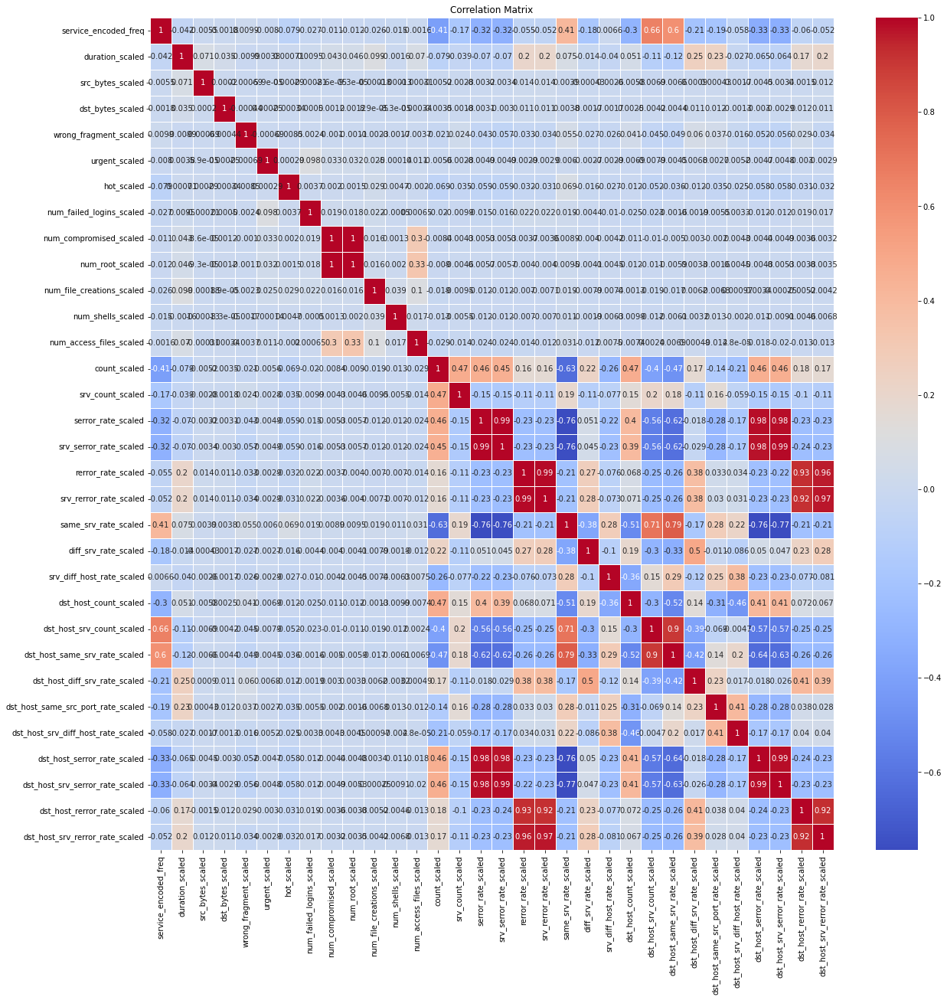

In [36]:
corr_matrix = train_dataset[numerical_cols].corr()
plt.figure(figsize=(20, 20))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

In [37]:
cols_to_drop = ['num_root_scaled', 'serror_rate_scaled', 'srv_serror_rate_scaled', 
                    'dst_host_serror_rate_scaled', 'dst_host_srv_serror_rate_scaled',
                    'rerror_rate_scaled', 'srv_rerror_rate_scaled', 
                    'dst_host_rerror_rate_scaled', 'dst_host_srv_rerror_rate_scaled']

train_dataset['serror_rate_combined'] = train_dataset['serror_rate_scaled'] + train_dataset['srv_serror_rate_scaled'] + train_dataset['dst_host_serror_rate_scaled'] + train_dataset['dst_host_srv_serror_rate_scaled']
train_dataset['rerror_rate_combined'] = train_dataset['rerror_rate_scaled'] + train_dataset['srv_rerror_rate_scaled'] + train_dataset['dst_host_rerror_rate_scaled'] + train_dataset['dst_host_srv_rerror_rate_scaled']
train_dataset = train_dataset.drop(columns=cols_to_drop)

test_dataset['serror_rate_combined'] = test_dataset['serror_rate_scaled'] + test_dataset['srv_serror_rate_scaled'] + test_dataset['dst_host_serror_rate_scaled'] + test_dataset['dst_host_srv_serror_rate_scaled']
test_dataset['rerror_rate_combined'] = test_dataset['rerror_rate_scaled'] + test_dataset['srv_rerror_rate_scaled'] + test_dataset['dst_host_rerror_rate_scaled'] + test_dataset['dst_host_srv_rerror_rate_scaled']
test_dataset = test_dataset.drop(columns=cols_to_drop)

### Random Forest Feature Importance

In [38]:
np.array(train_dataset.columns)

array(['land', 'logged_in', 'root_shell', 'su_attempted', 'is_host_login',
       'is_guest_login', 'attack', 'protocol_type_icmp',
       'protocol_type_tcp', 'protocol_type_udp', 'flag_OTH', 'flag_REJ',
       'flag_RSTO', 'flag_RSTOS0', 'flag_RSTR', 'flag_S0', 'flag_S1',
       'flag_S2', 'flag_S3', 'flag_SF', 'flag_SH', 'service_encoded_freq',
       'attack_category', 'is_attack', 'duration_scaled',
       'src_bytes_scaled', 'dst_bytes_scaled', 'wrong_fragment_scaled',
       'urgent_scaled', 'hot_scaled', 'num_failed_logins_scaled',
       'num_compromised_scaled', 'num_file_creations_scaled',
       'num_shells_scaled', 'num_access_files_scaled', 'count_scaled',
       'srv_count_scaled', 'same_srv_rate_scaled', 'diff_srv_rate_scaled',
       'srv_diff_host_rate_scaled', 'dst_host_count_scaled',
       'dst_host_srv_count_scaled', 'dst_host_same_srv_rate_scaled',
       'dst_host_diff_srv_rate_scaled',
       'dst_host_same_src_port_rate_scaled',
       'dst_host_srv_diff_host_

Text(0, 0.5, 'Feature Name')

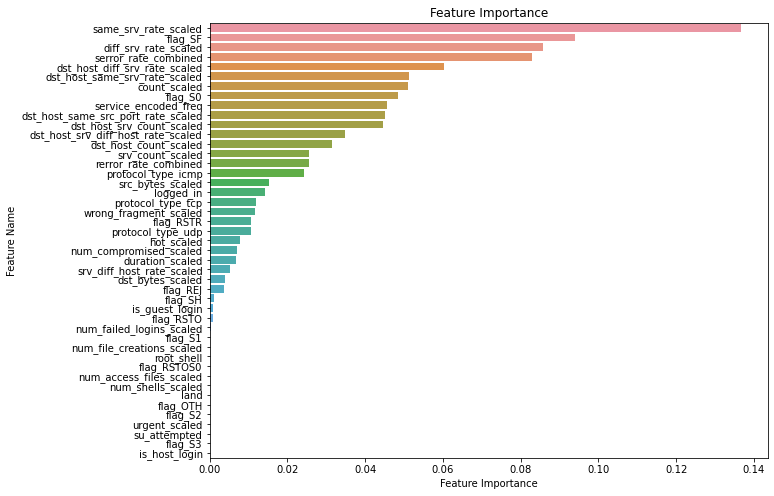

In [39]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectFromModel

X = train_dataset.drop(columns=['attack_category', 'is_attack', 'attack']) 
y = train_dataset['attack_category']

# Create a Random Forest classifier
model = RandomForestClassifier(n_estimators=100, random_state=42)  # Adjust parameters as needed

# Train the model on your data
model.fit(X, y)

# Get feature importance scores
feature_importances = model.feature_importances_

#Create a DataFrame using a Dictionary
fi_data={'feature_names': np.array(X.columns),'feature_importance':feature_importances}
fi_df = pd.DataFrame(fi_data)

#Sort the DataFrame in order decreasing feature importance
fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)

#Define size of bar plot
plt.figure(figsize=(10,8))
#Plot Searborn bar chart
sns.barplot(x=fi_df['feature_importance'], y=fi_df['feature_names'])
#Add chart labels
plt.title('Feature Importance')
plt.xlabel('Feature Importance')
plt.ylabel('Feature Name')

In [40]:
# Select the most important features
feature_selector = SelectFromModel(model, threshold=0.0001)
feature_selector.fit(X, y)
selected_features_rf = X.columns[feature_selector.get_support()]
useless_features_rf = [col for col in X.columns if col not in selected_features_rf ]
selected_features_rf

Index(['logged_in', 'root_shell', 'is_guest_login', 'protocol_type_icmp',
       'protocol_type_tcp', 'protocol_type_udp', 'flag_REJ', 'flag_RSTO',
       'flag_RSTOS0', 'flag_RSTR', 'flag_S0', 'flag_S1', 'flag_SF', 'flag_SH',
       'service_encoded_freq', 'duration_scaled', 'src_bytes_scaled',
       'dst_bytes_scaled', 'wrong_fragment_scaled', 'hot_scaled',
       'num_failed_logins_scaled', 'num_compromised_scaled',
       'num_file_creations_scaled', 'count_scaled', 'srv_count_scaled',
       'same_srv_rate_scaled', 'diff_srv_rate_scaled',
       'srv_diff_host_rate_scaled', 'dst_host_count_scaled',
       'dst_host_srv_count_scaled', 'dst_host_same_srv_rate_scaled',
       'dst_host_diff_srv_rate_scaled', 'dst_host_same_src_port_rate_scaled',
       'dst_host_srv_diff_host_rate_scaled', 'serror_rate_combined',
       'rerror_rate_combined'],
      dtype='object')

In [41]:
useless_features_rf

['land',
 'su_attempted',
 'is_host_login',
 'flag_OTH',
 'flag_S2',
 'flag_S3',
 'urgent_scaled',
 'num_shells_scaled',
 'num_access_files_scaled']

### Extra Tree Classifier

Text(0, 0.5, 'Feature Name')

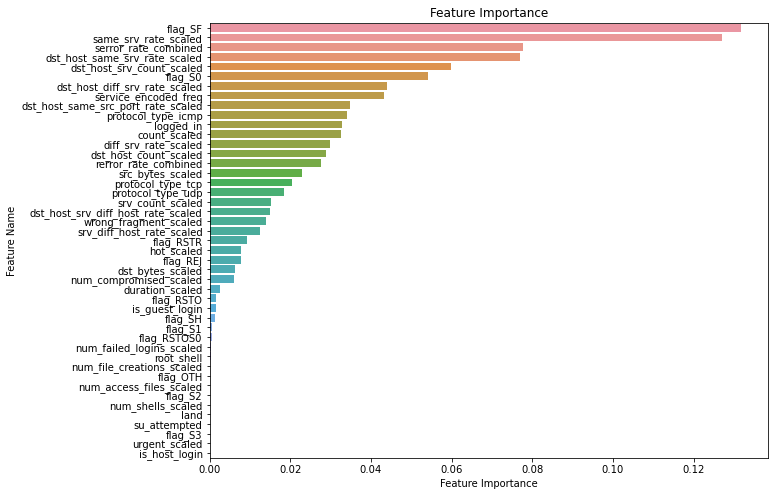

In [42]:
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.feature_selection import SelectFromModel

X = train_dataset.drop(columns=['attack_category', 'is_attack', 'attack']) 
y = train_dataset['attack_category']

# Create a Random Forest classifier
model = ExtraTreesClassifier(n_estimators=100, random_state=42)  # Adjust parameters as needed

# Train the model on your data
model.fit(X, y)

# Get feature importance scores
feature_importances = model.feature_importances_

#Create a DataFrame using a Dictionary
fi_data={'feature_names': np.array(X.columns),'feature_importance':feature_importances}
fi_df = pd.DataFrame(fi_data)

#Sort the DataFrame in order decreasing feature importance
fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)

#Define size of bar plot
plt.figure(figsize=(10,8))
#Plot Searborn bar chart
sns.barplot(x=fi_df['feature_importance'], y=fi_df['feature_names'])
#Add chart labels
plt.title('Feature Importance')
plt.xlabel('Feature Importance')
plt.ylabel('Feature Name')

In [43]:
# Select the most important features
feature_selector = SelectFromModel(model, threshold=0.0001)
feature_selector.fit(X, y)
selected_features_et = X.columns[feature_selector.get_support()]
useless_features_et = [col for col in X.columns if col not in selected_features_et ]
selected_features_et

Index(['logged_in', 'root_shell', 'is_guest_login', 'protocol_type_icmp',
       'protocol_type_tcp', 'protocol_type_udp', 'flag_OTH', 'flag_REJ',
       'flag_RSTO', 'flag_RSTOS0', 'flag_RSTR', 'flag_S0', 'flag_S1',
       'flag_SF', 'flag_SH', 'service_encoded_freq', 'duration_scaled',
       'src_bytes_scaled', 'dst_bytes_scaled', 'wrong_fragment_scaled',
       'hot_scaled', 'num_failed_logins_scaled', 'num_compromised_scaled',
       'num_file_creations_scaled', 'count_scaled', 'srv_count_scaled',
       'same_srv_rate_scaled', 'diff_srv_rate_scaled',
       'srv_diff_host_rate_scaled', 'dst_host_count_scaled',
       'dst_host_srv_count_scaled', 'dst_host_same_srv_rate_scaled',
       'dst_host_diff_srv_rate_scaled', 'dst_host_same_src_port_rate_scaled',
       'dst_host_srv_diff_host_rate_scaled', 'serror_rate_combined',
       'rerror_rate_combined'],
      dtype='object')

In [44]:
set(selected_features_et) - set(selected_features_rf)

{'flag_OTH'}

In [45]:
set(selected_features_rf) - set(selected_features_et)

set()

In [46]:
train_dataset_tree = train_dataset.copy().drop(columns = useless_features_rf )
test_dataset_tree = test_dataset.copy().drop(columns = useless_features_rf )

### PCA

In [47]:
from sklearn.decomposition import PCA

In [48]:
numerical_cols = [col for col in train_dataset.columns if ('_scaled' in col) or ('combined' in col)] + ['service_encoded_freq',]
numerical_cols

['duration_scaled',
 'src_bytes_scaled',
 'dst_bytes_scaled',
 'wrong_fragment_scaled',
 'urgent_scaled',
 'hot_scaled',
 'num_failed_logins_scaled',
 'num_compromised_scaled',
 'num_file_creations_scaled',
 'num_shells_scaled',
 'num_access_files_scaled',
 'count_scaled',
 'srv_count_scaled',
 'same_srv_rate_scaled',
 'diff_srv_rate_scaled',
 'srv_diff_host_rate_scaled',
 'dst_host_count_scaled',
 'dst_host_srv_count_scaled',
 'dst_host_same_srv_rate_scaled',
 'dst_host_diff_srv_rate_scaled',
 'dst_host_same_src_port_rate_scaled',
 'dst_host_srv_diff_host_rate_scaled',
 'serror_rate_combined',
 'rerror_rate_combined',
 'service_encoded_freq']

In [49]:
train_with_pca = train_dataset.copy().drop(columns = numerical_cols)
test_with_pca = test_dataset.copy().drop(columns = numerical_cols)

In [50]:
# Generate PCA components on training data
pca = PCA(0.99)

pca_features_train = pca.fit_transform(train_dataset[numerical_cols])

pca_features_train_df = pd.DataFrame(pca_features_train)
pca_features_train_df.columns = ['PCA' + str(i) for i in range(1,len(pca_features_train[0]) + 1)]
train_with_pca = pd.concat([train_with_pca, pca_features_train_df], axis=1)

# Transform test data
pca_features_test = pca.transform(test_dataset[numerical_cols])

pca_features_test_df = pd.DataFrame(pca_features_test)
pca_features_test_df.columns = ['PCA' + str(i) for i in range(1,len(pca_features_test[0]) + 1)]
test_with_pca = pd.concat([test_with_pca, pca_features_test_df], axis=1)

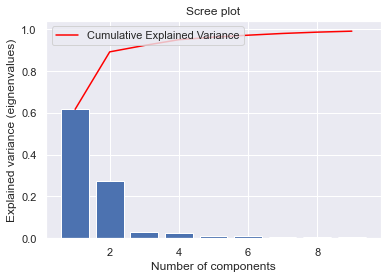

In [51]:
sns.set()
# Bar plot of explained_variance
plt.bar(
    range(1,len(pca.explained_variance_ratio_)+1),
    pca.explained_variance_ratio_
    )

plt.plot(
    range(1,len(pca.explained_variance_ratio_ )+1),
    np.cumsum(pca.explained_variance_ratio_),
    c='red',
    label='Cumulative Explained Variance')

plt.legend(loc='upper left')
plt.xlabel('Number of components')
plt.ylabel('Explained variance (eignenvalues)')
plt.title('Scree plot')

plt.show()

In [52]:
import plotly.express as px

total_var = pca.explained_variance_ratio_[0:3].sum()
fig = px.scatter_3d(
    [row[0:3] for row in pca_features_train], x=0, y=1, z=2, color=train_with_pca['is_attack'].astype('category'),
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)

fig.show()

In [53]:
import plotly.express as px

total_var = pca.explained_variance_ratio_[0:3].sum()
fig = px.scatter_3d(
    [row[0:3] for row in pca_features_train], x=0, y=1, z=2, color=train_with_pca['attack_category'].astype('category'),
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)

fig.show()

In [54]:
loadings_pca1 = np.absolute(pca.components_[0])
index = np.argsort(np.absolute(loadings_pca1))
values = np.sort(np.absolute(loadings_pca1))
print("Loadings of PCA:", loadings_pca1)

Loadings of PCA: [2.68254959e-03 1.00043394e-05 6.80457277e-06 1.88538668e-03
 9.83900408e-06 7.00772297e-04 7.42078657e-05 6.72421044e-06
 2.09770938e-05 5.19501461e-05 1.10913100e-04 5.36250508e-02
 9.76886045e-03 1.74486584e-01 4.58224958e-03 3.15537190e-02
 8.62455750e-02 1.29120154e-01 1.49467651e-01 3.87015590e-03
 4.55169897e-02 1.12241010e-02 9.34115564e-01 2.09201215e-01
 2.35536836e-02]


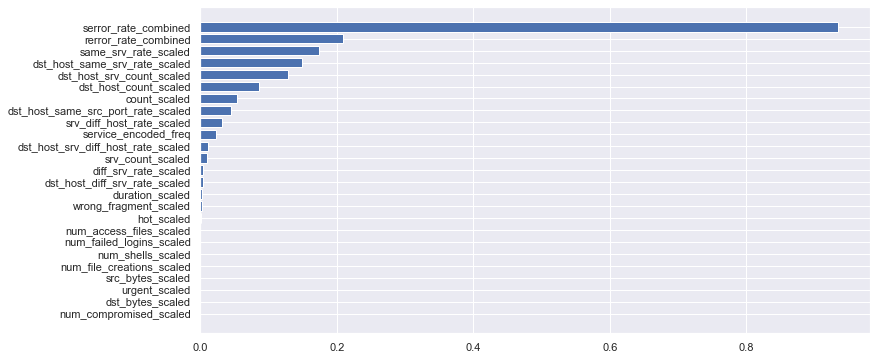

In [55]:
fig = plt.figure(figsize = [12, 6])
plt.barh(
    range(1,len(numerical_cols)+1),
    values,
    tick_label = [numerical_cols[ind] for ind in index ]
    )
plt.show()

In [56]:
train_with_pca.columns

Index(['land', 'logged_in', 'root_shell', 'su_attempted', 'is_host_login',
       'is_guest_login', 'attack', 'protocol_type_icmp', 'protocol_type_tcp',
       'protocol_type_udp', 'flag_OTH', 'flag_REJ', 'flag_RSTO', 'flag_RSTOS0',
       'flag_RSTR', 'flag_S0', 'flag_S1', 'flag_S2', 'flag_S3', 'flag_SF',
       'flag_SH', 'attack_category', 'is_attack', 'PCA1', 'PCA2', 'PCA3',
       'PCA4', 'PCA5', 'PCA6', 'PCA7', 'PCA8', 'PCA9'],
      dtype='object')

In [57]:
test_with_pca.columns

Index(['land', 'logged_in', 'root_shell', 'su_attempted', 'is_host_login',
       'is_guest_login', 'attack', 'protocol_type_icmp', 'protocol_type_tcp',
       'protocol_type_udp', 'flag_OTH', 'flag_REJ', 'flag_RSTO', 'flag_RSTOS0',
       'flag_RSTR', 'flag_S0', 'flag_S1', 'flag_S2', 'flag_S3', 'flag_SF',
       'flag_SH', 'attack_category', 'is_attack', 'PCA1', 'PCA2', 'PCA3',
       'PCA4', 'PCA5', 'PCA6', 'PCA7', 'PCA8', 'PCA9'],
      dtype='object')

In [58]:
set(train_with_pca.columns) - set(test_with_pca.columns)

set()

In [59]:
set(test_with_pca.columns) - set(train_with_pca.columns)

set()

In [60]:
train_dataset.to_csv('Datasets/train_dataset.csv', encoding='utf-8', index=False)
test_dataset.to_csv('Datasets/test_dataset.csv', encoding='utf-8', index=False)

train_with_pca.to_csv('Datasets/PCA_train_data.csv', encoding='utf-8', index=False)
test_with_pca.to_csv('Datasets/PCA_test_data.csv', encoding='utf-8', index=False)

train_dataset_tree.to_csv('Datasets/Tree_train_data.csv', encoding='utf-8', index=False)
test_dataset_tree.to_csv('Datasets/Tree_test_data.csv', encoding='utf-8', index=False)

## EXTRA (NOT IMPT DONT DELETE)

In [ ]:
# from sklearn.model_selection import train_test_split, GridSearchCV
# from sklearn.linear_model import LogisticRegression
# from sklearn.tree import DecisionTreeClassifier
# from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
# from xgboost import XGBClassifier
# from sklearn.neighbors import KNeighborsClassifier
# from sklearn.metrics import accuracy_score
# from sklearn.metrics import classification_report
# from sklearn.metrics import confusion_matrix
# from pandas.plotting import scatter_matrix
# from sklearn.model_selection import cross_val_score
# from sklearn.model_selection import StratifiedKFold

In [ ]:
# X = train_with_pca.drop(columns=['attack_category', 'is_attack', 'attack']) 
# y = train_with_pca['attack_category']

In [ ]:
# #train test split with stratify to ensure similar distribution of sample
# X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=42, stratify=y)

In [ ]:
# models = []
# models.append(("Logistic Regression", LogisticRegression()))
# models.append(('Decision Tree', DecisionTreeClassifier()))
# models.append(('Random Forest', RandomForestClassifier()))
# models.append(('KNN', KNeighborsClassifier()))
# models.append(('AdaBoost', AdaBoostClassifier()))
# models.append(('XGBoost', XGBClassifier()))
# models.append(('GradientBoosting', GradientBoostingClassifier()))

In [ ]:
# # Evaluating performance of different models
# results = []
# names = []

# for name, model in models:
#   # Stratified K fold
#     kfold = StratifiedKFold(n_splits=10, random_state=1, shuffle=True)
#     cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
#     results.append(cv_results)
#     names.append(name)
#     print("cv_results", cv_results)
#     print('%s: %f (%f)' % (name, cv_results.mean(), cv_results.std()))
#     print()

In [ ]:
# #Summary of the best model among all the models
# best_model = names[np.argmax([result.mean() for result in results])]
# best_accuracy = results[ np.argmax([result.mean() for result in results])].mean()

# print(f"The best model is {best_model} with an accuracy of {best_accuracy:.4f}.")

In [ ]:
# #Box Plot to understand the results to identify outliers
# plt.figure(figsize=(10, 6))
# plt.boxplot(results, labels=names, showmeans=True, patch_artist=True)
# plt.xticks(rotation=45)
# plt.xlabel('Classifier')
# plt.ylabel('Accuracy')
# plt.title('CV results for different classifiers')
# plt.grid(axis='y', linestyle='--', alpha=0.5)
# plt.show()

In [ ]:
# from sklearn.metrics import f1_score

# xgb_model = XGBClassifier()

# # Define the hyperparameter grid to search
# param_grid = {
#     'learning_rate': [0.1],
#     'n_estimators': [100],
#     'max_depth': [ 5],
#     'min_child_weight': [3],
#     'subsample': [0.8],
#     'colsample_bytree': [0.8]
# }

# # Create the GridSearchCV object
# grid_search = GridSearchCV(
#     estimator=xgb_model,
#     param_grid=param_grid,
#     scoring='f1_weighted',  # Use F1 score for classification
#     cv=10,  # Number of cross-validation folds
#     n_jobs=-1  # Use all available CPU cores
# )

# # Fit the grid search to the training data
# grid_search.fit(X_train, y_train)

# # Print the best parameters and the corresponding score
# print("Best Parameters: ", grid_search.best_params_)
# print("Best Score: ", grid_search.best_score_)

# # Evaluate the model on the test set
# y_pred = grid_search.best_estimator_.predict(X_test)
# f1 = f1_score(y_test, y_pred, average='weighted')  # Use 'weighted' for multi-class classification
# print("Test F1 Score: ", f1)

In [ ]:
# from sklearn.metrics import f1_score
# rf_model = RandomForestClassifier()

# # Define the hyperparameter grid to search
# param_grid = {
#     'n_estimators': [50, 100],
#     'max_depth': [ 10 ],
#     'min_samples_split': [ 7],
#     'min_samples_leaf': [ 4],
#     'max_features': ['auto'],
#     'bootstrap': [True]
# }

# # Create the GridSearchCV object
# grid_search = GridSearchCV(
#     estimator=rf_model,
#     param_grid=param_grid,
#     scoring='f1_weighted',  # Use weighted F1 score for multi-class classification
#     cv=10,  # Number of cross-validation folds
#     n_jobs=-1  # Use all available CPU cores
# )

# # Fit the grid search to the training data
# grid_search.fit(X_train, y_train)

# # Print the best parameters and the corresponding score
# print("Best Parameters: ", grid_search.best_params_)
# print("Best Score: ", grid_search.best_score_)

# # Evaluate the model on the test set
# y_pred = grid_search.best_estimator_.predict(X_test)
# f1 = f1_score(y_test, y_pred, average='weighted')
# print("Test F1 Score: ", f1)

In [ ]:
# predict_train = grid_search.best_estimator_.predict(X_train)
# print(f"accuracy score : {accuracy_score(y_train, predict_train):.4f}")
# print()
# print(confusion_matrix(y_train, predict_train))
# print()
# print(classification_report(y_train, predict_train))

In [ ]:
# predict_test = grid_search.best_estimator_.predict(X_test)
# print(f"accuracy score : {accuracy_score(y_test, predict_test):.4f}")
# print()
# print(confusion_matrix(y_test, predict_test))
# print()
# print(classification_report(y_test, predict_test))

In [ ]:
# y_test_dataset = test_with_pca['attack_category']
# X_test_dataset = test_with_pca.drop(columns=['attack_category', 'is_attack', 'attack']) 

# predicted = grid_search.best_estimator_.predict(X_test_dataset)
# print(f"accuracy score : {accuracy_score(y_test_dataset, predicted):.4f}")
# print()
# print(confusion_matrix(y_test_dataset, predicted))
# print()
# print(classification_report(y_test_dataset, predicted))
# print()
# f1 = f1_score(y_test, y_pred, average='weighted')
# print(f1)